<a href="https://colab.research.google.com/github/louisbrown1/eth_example_notebook/blob/main/Times_Series_Forecasting.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Business Questions

Question 1: Is there any pattern or repetition in hourly ethereum price?

Question 2: Do we see any signicant trend in the dataset?

Question 3: Can we predict the hourly price of Ethereum?

In [ ]:
## installing files that are not pre-loaded on Google Colab!
!pip install -U ydata-profiling
!pip install pycodestyle pycodestyle_magic
!pip install EMD-signal

In [2]:

# let's load the datasets we need
import pandas as pd
import numpy as np
from ydata_profiling import ProfileReport

# Section 2: Data Understanding

## Gather Data
We will get the required data from cryptodownload

In [3]:
# remove the 1st row as it says cryptodownload
path = 'https://www.cryptodatadownload.com/cdd/Bitstamp_ETHUSD_1h.csv'
hourly_eth_data = pd.read_csv(path, skiprows=1)

## Assess data

We will use ydata_profiling previously known as Panda profiling to create initial data reports

In [4]:

hourly_data_report = ProfileReport(hourly_eth_data, title="Hourly ily Eth Report")

print out the initial report

In [ ]:
hourly_data_report

#Section 3: Data Preparation

##Data Processing

Reverse the datasets order!

In [6]:
hourly_eth_data = hourly_eth_data.iloc[::-1]

Remove columns which we will not use for analysis and rename columns.

In [7]:
hourly_eth_data = hourly_eth_data.rename(columns={'unix':'unix','date':'date','symbol':'symbol',
                                'open':'open','high':'high','low':'low',
                                'close':'close','Volume ETH':'volume_eth',
                                'Volume USD':'volume_usd'})

hourly_eth_data.drop(['unix', 'symbol'],axis=1, inplace=True )

In [8]:
hourly_eth_data

,date,open,high,low,close,volume_eth,volume_usd
45810,2018-05-15 06:00:00,732.10,736.67,730.94,733.00,7.662087e+05,1043.910000
45809,2018-05-15 07:00:00,733.00,735.99,730.45,733.82,2.594569e+05,353.820000
45808,2018-05-15 08:00:00,733.82,734.92,721.58,731.68,2.860231e+06,3924.550000
45807,2018-05-15 09:00:00,731.68,731.82,726.98,727.32,4.384113e+05,601.030000
45806,2018-05-15 10:00:00,727.32,739.37,725.04,733.59,1.424388e+06,1943.150000
...,...,...,...,...,...,...,...
4,2023-08-05 20:00:00,1833.40,1833.80,1832.00,1833.00,4.916790e+01,90124.765154
3,2023-08-05 21:00:00,1832.90,1835.10,1832.80,1833.40,6.448108e+01,118219.616839
2,2023-08-05 22:00:00,1833.40,1837.00,1832.90,1836.80,1.130263e+02,207606.751335
1,2023-08-05 23:00:00,1836.80,1836.80,1835.00,1835.00,6.917055e+01,126927.960406


**Treatment of missing values**

No columns have missing values however, we do know that columns with zero volume means that no trade occured. This data has been treated by the dataset creators by taking the previous data and filling down.

I will change this imputation into a doing a linear interpolation between the previous datapoint and the next datapoint where volume is not zero.



1.   Remove datapoints where the volume is zero and set to na.
2.   Interpolate between previous datapoint and the next filled in datapoint.

This assumes that a trade occured within the period that bridges the difference between the two periods.


In [9]:
def interpolate_ohlc(data):
    '''
    this function replaces OHLC data where the volume is zero and does linear interpolation between all the columns
    input:
    OHLC dataframe
        data : pandas.DataFrame
        DataFrame that contains 'date','open', 'high', 'low', 'close','volume_usd', 'volume_eth' columns.


    Output:
    OHLC dataframe with interpolated values
    '''
    # Replace the OHLC values with NaN where volume is 0
    data.loc[data['volume_usd'] == 0, ['open', 'high', 'low', 'close','volume_usd','volume_eth']] = np.nan

    data[['open', 'high', 'low', 'close','volume_usd','volume_eth']] = data[['open', 'high', 'low', 'close','volume_usd','volume_eth']].interpolate(method='linear')

    return data



In [10]:
# call function
hourly_eth_data =interpolate_ohlc(hourly_eth_data)

In [11]:
# build second report to check changes
hourly_data_report_2 = ProfileReport(hourly_eth_data, title="Hourly Eth Report after interpolation")


In [ ]:
hourly_data_report_2

In [13]:
hourly_eth_data # interactive data table see results of interpolation

,date,open,high,low,close,volume_eth,volume_usd
45810,2018-05-15 06:00:00,732.10,736.67,730.94,733.00,7.662087e+05,1043.910000
45809,2018-05-15 07:00:00,733.00,735.99,730.45,733.82,2.594569e+05,353.820000
45808,2018-05-15 08:00:00,733.82,734.92,721.58,731.68,2.860231e+06,3924.550000
45807,2018-05-15 09:00:00,731.68,731.82,726.98,727.32,4.384113e+05,601.030000
45806,2018-05-15 10:00:00,727.32,739.37,725.04,733.59,1.424388e+06,1943.150000
...,...,...,...,...,...,...,...
4,2023-08-05 20:00:00,1833.40,1833.80,1832.00,1833.00,4.916790e+01,90124.765154
3,2023-08-05 21:00:00,1832.90,1835.10,1832.80,1833.40,6.448108e+01,118219.616839
2,2023-08-05 22:00:00,1833.40,1837.00,1832.90,1836.80,1.130263e+02,207606.751335
1,2023-08-05 23:00:00,1836.80,1836.80,1835.00,1835.00,6.917055e+01,126927.960406


In [14]:
profile_time_report = ProfileReport(hourly_eth_data, tsmode=True, sortby="date", title="Eth Times-series report")

In [ ]:
profile_time_report

## Data Processing

Based on the information regarding non-stationarity we will create some lagged variables and difference variables for forecast modelling.

In [16]:
def create_lags_and_diff(df, column, max_lag):
    """
    Create lagged and differenced data for a specified column in the dataframe.

    Parameters:
    df (pd.DataFrame): The input dataframe.
    column (str): The column on which to perform the lags and difference.
    max_lag (int): The maximum number of lags/differences.

    Returns:
    df (pd.DataFrame): The dataframe with added lagged and differenced columns.
    """
    for i in range(1, max_lag+1):
        # Create lagged column
        df[f'{column}_lag{i}'] = df[column].shift(i)
        # Create differenced column
        df[f'{column}_diff{i}'] = df[column].diff(i)

    return df

Due to the highly correlated variables open, high, low, close. We will remove the open, high, low variables and only work with the close value.

In [17]:
hourly_eth_data.drop(['high','open','low'],axis=1, inplace=True )

In [18]:
list(map(lambda column: create_lags_and_diff(hourly_eth_data, column, 5), ['close']))


[                      date    close    volume_eth     volume_usd  close_lag1  \
 45810  2018-05-15 06:00:00   733.00  7.662087e+05    1043.910000         NaN   
 45809  2018-05-15 07:00:00   733.82  2.594569e+05     353.820000      733.00   
 45808  2018-05-15 08:00:00   731.68  2.860231e+06    3924.550000      733.82   
 45807  2018-05-15 09:00:00   727.32  4.384113e+05     601.030000      731.68   
 45806  2018-05-15 10:00:00   733.59  1.424388e+06    1943.150000      727.32   
 ...                    ...      ...           ...            ...         ...   
 4      2023-08-05 20:00:00  1833.00  4.916790e+01   90124.765154     1833.40   
 3      2023-08-05 21:00:00  1833.40  6.448108e+01  118219.616839     1833.00   
 2      2023-08-05 22:00:00  1836.80  1.130263e+02  207606.751335     1833.40   
 1      2023-08-05 23:00:00  1835.00  6.917055e+01  126927.960406     1836.80   
 0      2023-08-06 00:00:00  1834.20  6.623481e+01  121487.881991     1835.00   
 
        close_diff1  close

We have now created new missing variables by performing the lag and differences. These missing variables will not have any modelling value and so will be deleted.

In [19]:
hourly_eth_data = hourly_eth_data.dropna()

In [20]:
# Convert the 'date' column to datetime
dates = pd.to_datetime(hourly_eth_data['date'])

# Get the day of the week (Monday=0, Sunday=6)
hourly_eth_data['weekday'] = dates.dt.weekday

# Get the hour of the day
hourly_eth_data['hour'] = dates.dt.hour

# Get the month
hourly_eth_data['month'] = dates.dt.month

<ipython-input-20-5c1f16d2aa7f>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hourly_eth_data['weekday'] = dates.dt.weekday
<ipython-input-20-5c1f16d2aa7f>:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  hourly_eth_data['hour'] = dates.dt.hour
<ipython-input-20-5c1f16d2aa7f>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/sta

#Section 4: Data Modelling


In this section we will build 3 models to check whether we can predict the price of ethereum as per the business. The models that we will use are:-


*   1-hour price lag.
*   Linear model.

In [21]:
hourly_eth_data.columns.tolist()

['date',
 'close',
 'volume_eth',
 'volume_usd',
 'close_lag1',
 'close_diff1',
 'close_lag2',
 'close_diff2',
 'close_lag3',
 'close_diff3',
 'close_lag4',
 'close_diff4',
 'close_lag5',
 'close_diff5',
 'weekday',
 'hour',
 'month']

In [22]:
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import HistGradientBoostingRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score, mean_squared_error
from sklearn.model_selection import TimeSeriesSplit

## base model
We will create a simple model for comparison using the lag 1 and to predict the close.

In [23]:
def plot_series(time, series, format="-", start=0, end=None, label=None):
    """
    Plot a time series.

    Parameters
    ----------
    time : array-like
        Array-like object of times / indices.
    series : array-like
        Array-like object of values corresponding to 'time' points.
    format : str, optional
        Style string for how the plot is formatted. See matplotlib plot for options. (default is "-")
    start : int, optional
        The index to start the plot from (default is 0).
    end : int, optional
        The index to end the plot at. If None, plot will end at the last value (default is None).
    label : str, optional
        Label for the series. Will be used in the legend if provided (default is None).

    Returns
    -------
    None

    Notes
    -----
    This function creates a plot and then shows it. It does not save the plot or return a handle to the plot.
    """
    plt.plot(time[start:end], series[start:end], format, label=label)
    plt.xlabel("Time")
    plt.ylabel("Value")
    if label:
        plt.legend(fontsize=14)
    plt.grid(True)

Create datesets for the model train test and validation.

In [24]:
#Split into explanatory and response variables
valid = hourly_eth_data.tail(1000)
valid_dates = valid['date']
valid = valid.drop(columns='date')
train_test = hourly_eth_data[:-1000]
X = train_test.drop(['close'], axis=1)
y= train_test['close']
x_valid = valid.drop(['close'], axis=1)
y_valid = valid['close']

Get the R^2 and the MSE for this model.

In [25]:
r2_score(y_valid, x_valid['close_lag1'])

0.9671243497138918

In [26]:
mean_squared_error(y_valid, x_valid['close_lag1'])

45.378595000000004

Plot the predicted vs. actual of the model.

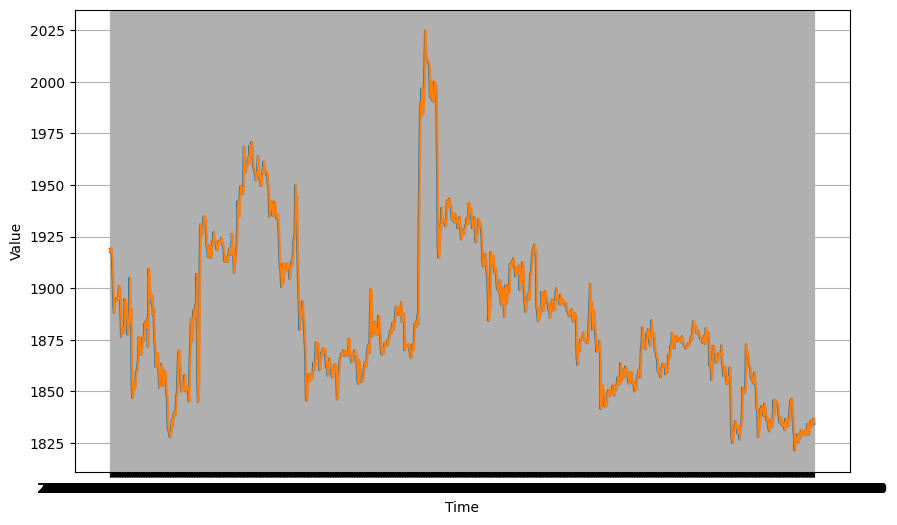

In [27]:
plt.figure(figsize=(10, 6))
plot_series(valid_dates, y_valid)
plot_series(valid_dates, x_valid['close_lag1'])

Check the model residuals using by regressing the actual vs predicted.

In [28]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [29]:
comp = pd.concat([y_valid,x_valid['close_lag1']], axis=1)
comp=comp.rename(columns={'close':'actual','close_lag1':'pred'})
# fit simple linear regression model
linear_model = sm.OLS(comp['actual'],comp['pred']).fit()

                                 OLS Regression Results                                
Dep. Variable:                 actual   R-squared (uncentered):                   1.000
Model:                            OLS   Adj. R-squared (uncentered):              1.000
Method:                 Least Squares   F-statistic:                          7.832e+07
Date:                Sun, 06 Aug 2023   Prob (F-statistic):                        0.00
Time:                        19:03:37   Log-Likelihood:                         -3326.4
No. Observations:                1000   AIC:                                      6655.
Df Residuals:                     999   BIC:                                      6660.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

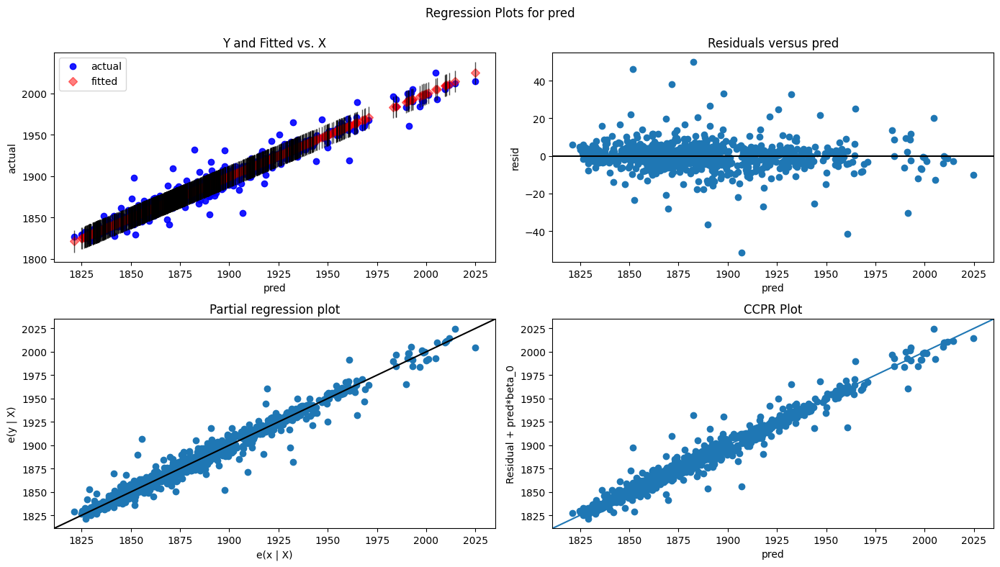

In [30]:
# display model summary
print(linear_model.summary())

# modify figure size
fig = plt.figure(figsize=(14, 8))

# creating regression plots
fig = sm.graphics.plot_regress_exog(linear_model,
                                    'pred',
                                    fig=fig)

Produce a scatter plot to ensure that the residuals behave correctly across time.

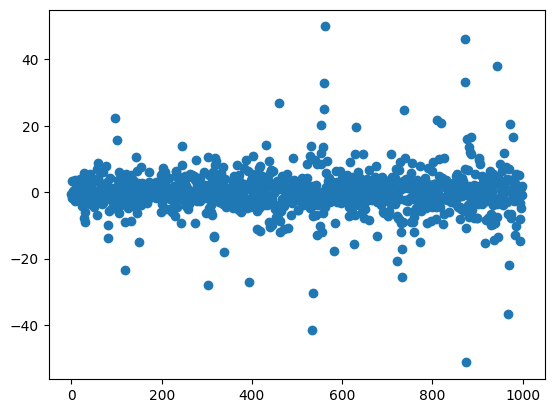

In [31]:
plt.scatter(valid.index, linear_model.resid)

plt.show()

## Linear Regression Model

Create the dataset and setup the cross validation method.

In [32]:
train_size=int(len(hourly_eth_data)*(1-0.2))
test_size=len(hourly_eth_data) - train_size


In [33]:
ts_cv = TimeSeriesSplit(
    n_splits=3,
    gap=72,
    max_train_size=train_size,
    test_size=test_size,
)



In [34]:
from sklearn.model_selection import cross_validate
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import RidgeCV
from sklearn.preprocessing import MinMaxScaler, OneHotEncoder

def evaluate(model, X, y, cv):
    """
    Evaluates a model using cross-validation and prints the Mean Absolute Error (MAE),
    Root Mean Squared Error (RMSE), and Mean Squared Error (MSE) along with their standard deviations.

    Parameters
    ----------
    model : A scikit-learn compatible estimator.
    X : Input data for cross-validation.
    y : Target data for cross-validation.
    cv : Cross-validation splitting strategy.

    Returns
    -------
    None
    """
    cv_results = cross_validate(
        model,
        X,
        y,
        cv=cv,
        scoring=["neg_mean_absolute_error", "neg_root_mean_squared_error","neg_mean_squared_error"],
    )
    mae = -cv_results["test_neg_mean_absolute_error"]
    rmse = -cv_results["test_neg_root_mean_squared_error"]
    mse = -cv_results["test_neg_mean_squared_error"]
    print(
        f"Mean Absolute Error:     {mae.mean():.3f} +/- {mae.std():.3f}\n"
        f"Root Mean Squared Error: {rmse.mean():.3f} +/- {rmse.std():.3f}\n"
        f"Mean Squared Error: {mse.mean():.3f} +/- {mse.std():.3f}"
    )

List of categorical variables and their treatments.

In [35]:
X = X.drop(columns='date')
categorical_columns = [
    "weekday",
    "month",
    "hour",
]

categories = [
    [0, 1, 2, 3, 4, 5, 6],
    [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
    [0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23],
]

Create X and y variables for Linear model remove all variables that are non-stationary. The Dependent variable will be close_diff1 as this is a stationary.

In [36]:
## model the stationary variables y=close_diff1.  final model will be close = pred+close_lag1
X_new = X[X.columns.drop(list(X.filter(regex='lag')))]
X_new = X_new.drop(columns=['close_diff1'],axis=1)
y_new = X['close_diff1']
x_valid_new = x_valid[x_valid.columns.drop(list(x_valid.filter(regex='lag')))]
x_valid_new = x_valid_new.drop(columns=['close_diff1'],axis=1)
y_valid_new =x_valid['close_diff1']

Create a Sklearn linear pipeline.

In [37]:
from sklearn.compose import ColumnTransformer

one_hot_encoder = OneHotEncoder(handle_unknown="ignore", sparse_output=False)
alphas = np.logspace(-6, 6, 25)
naive_linear_pipeline = make_pipeline(
    ColumnTransformer(
        transformers=[
            ("categorical", one_hot_encoder, categorical_columns),
        ],
        remainder=MinMaxScaler(),
    ),
    RidgeCV(alphas=alphas),
)


evaluate(naive_linear_pipeline, X_new, y_new, cv=ts_cv)

Mean Absolute Error:     8.532 +/- 4.069
Root Mean Squared Error: 13.793 +/- 4.828
Mean Squared Error: 213.546 +/- 135.789


In [38]:
naive_linear_pipeline.fit(X_new, y_new)
l_predict = naive_linear_pipeline.predict(x_valid_new)
l_predict = pd.DataFrame(l_predict+x_valid['close_lag1'])
l_predict.columns = ['pred']

Check the model plot of actual vs predicted.

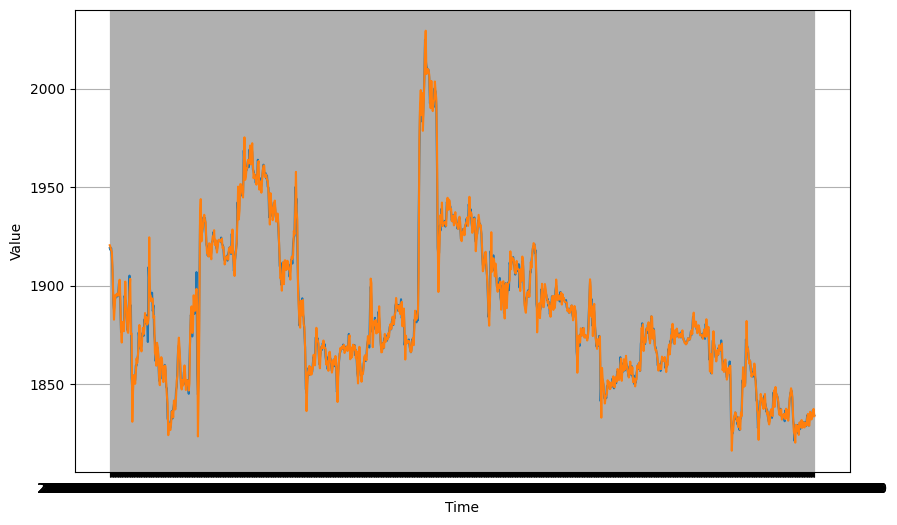

In [39]:
plt.figure(figsize=(10, 6))
plot_series(valid_dates, y_valid)
plot_series(valid_dates, l_predict)

Plot the residuals to see their behaviour.

In [40]:
comp = pd.concat([y_valid,l_predict], axis=1)

comp=comp.rename(columns={'close':'actual','pred':'pred'})
# fit simple linear regression model
linear_model = sm.OLS(comp['actual'],comp['pred']).fit()

                                 OLS Regression Results                                
Dep. Variable:                 actual   R-squared (uncentered):                   1.000
Model:                            OLS   Adj. R-squared (uncentered):              1.000
Method:                 Least Squares   F-statistic:                          1.674e+08
Date:                Sun, 06 Aug 2023   Prob (F-statistic):                        0.00
Time:                        19:03:51   Log-Likelihood:                         -2946.6
No. Observations:                1000   AIC:                                      5895.
Df Residuals:                     999   BIC:                                      5900.
Df Model:                           1                                                  
Covariance Type:            nonrobust                                                  
                 coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------

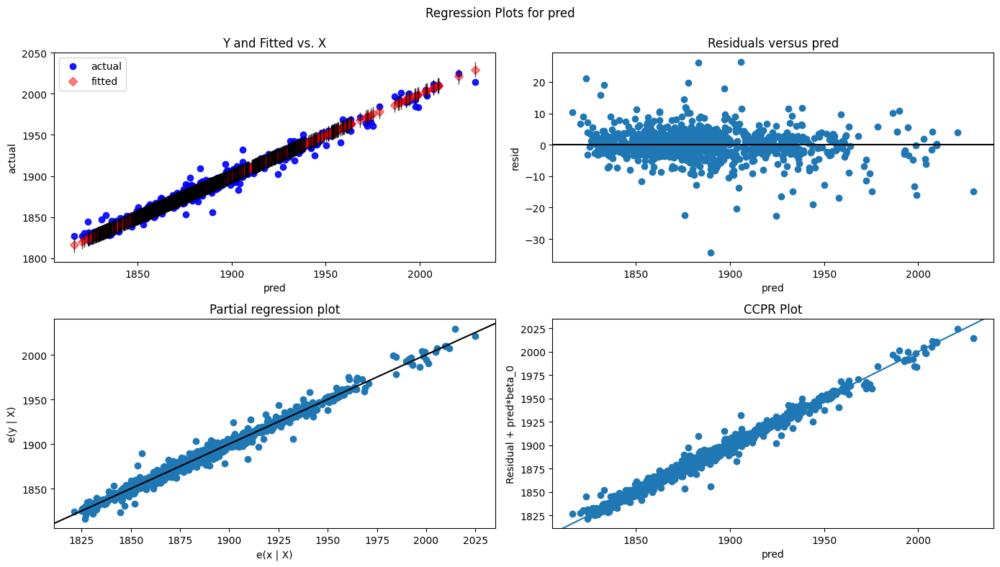

In [41]:
# display model summary
print(linear_model.summary())

# modify figure size
fig = plt.figure(figsize=(14, 8))

# creating regression plots
fig = sm.graphics.plot_regress_exog(linear_model,
                                    'pred',
                                    fig=fig)

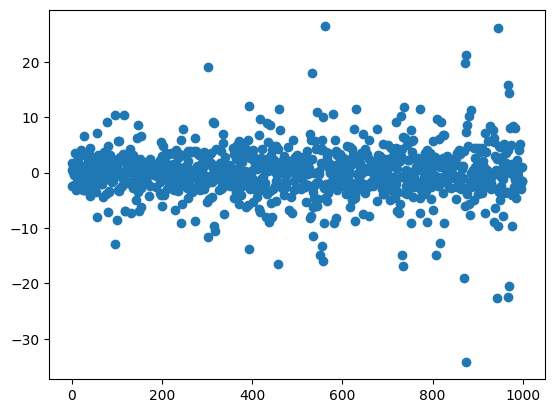

In [42]:
plt.scatter(valid.index, linear_model.resid)

plt.show()

In [43]:
linear_r2 = r2_score(y_valid, l_predict)
linear_r2

0.9846209381779253

In [44]:
linear_mse = mean_squared_error(y_valid, l_predict)
linear_mse

21.227875702242283

#Section 5: Evaluate Results

In [45]:
timeseriesreport2 = ProfileReport(hourly_eth_data, tsmode=True, sortby="date", title="Eth Times-series report 2")

In [46]:
timeseriesreport2

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Question 1: Is there any pattern or repetition in hourly ethereum price?

The report 'Eth Time-Series' has shown that seasonality exists in the hourly close price Ethereum dataset. We can further decompose the series using Complete Ensemble Emprical Mode Decomposition (CEEMDAN), this will help us find the repeating elements of the timeseries known as Intrisic Mode Functions (IMFs).  

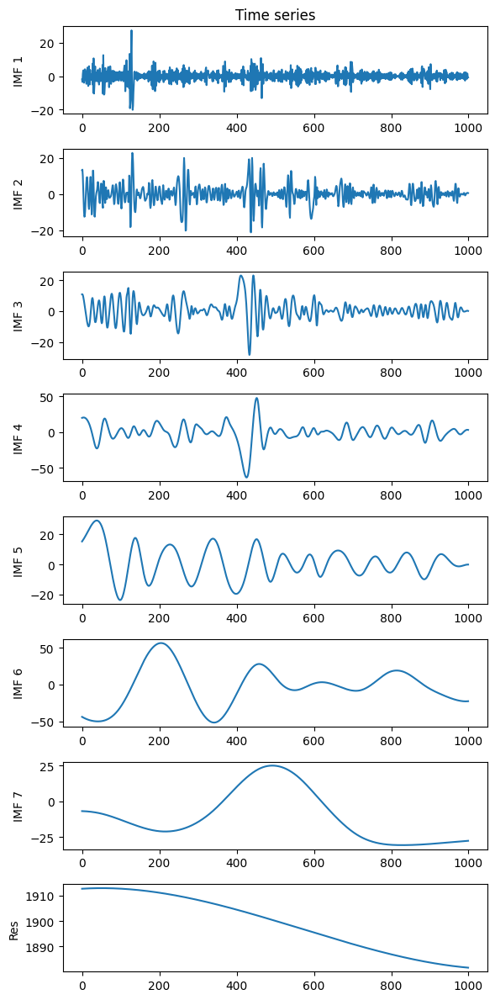

In [47]:
from PyEMD import CEEMDAN
from PyEMD import Visualisation
ceemdan = CEEMDAN()(np.array(y_valid))
imfs, res = ceemdan[:-1], ceemdan[-1]
vis = Visualisation()
vis.plot_imfs(imfs, res)

Decompsing the series we can see that there are 6 repeating or seasonal patterns (although IMF 1 is very high frequency).

## Question 2: Do we see any signicant trend in the dataset?

We can see from the data that currently Ethereum has a downward trend based on the residue (Res) from the 1000 data points before the 05/08/2023.

## Question 3: Can we predict the hourly price of Ethereum?

We built two models, a simple one based on the 1-hour lag close price being used as the future price. This model has an R^2 of 0.96 and MSE ~$46; this shows that we can create a price prediction for Ethereum. Also, the charts of the residue show that the predictions are mostly well-behaved.

Second, we create a linear regression model using differences and adding this back to the lag1 close price. We can see again that the model has well-behaved residuals, and the forecast R^2 and MSE have improved significantly. This does indeed answer the business question that the Ethereum price is forecastable.